# 2D spatial understanding with Gemini 2.0

This notebook introduces object detection and spatial understanding with the Gemini API like in the Spatial understanding example from AI Studio and demonstrated in the Building with Gemini 2.0: Spatial understanding video.

You'll learn how to use Gemini the same way as in the demo and perform object detection like this:

![BBOX Cupcakes](https://storage.googleapis.com/generativeai-downloads/images/cupcakes_with_bbox.png)

There are many examples, including object detection with

- simply overlaying information
- searching within an image
- translating and understanding things in multiple languages
- using Gemini thinking abilities

:::{.callout-note}

There's no "magical prompt". Feel free to experiment with different ones. You can use the dropdown to see different samples, but you can also write your own prompts. Also, you can try uploading your own images.

:::


## Setup

### Install the Google GenAI SDK

Install the Google GenAI SDK from [npm](https://www.npmjs.com/package/@google/genai). 

```bash
$ npm install @google/genai
```

### Setup your API key

You can [create](https://aistudio.google.com/app/apikey) your API key using Google AI Studio with a single click.

Remember to treat your API key like a password. Don't accidentally save it in a notebook or source file you later commit to GitHub. In this notebook we will be storing the API key in a `.env` file. You can also set it as an environment variable or use a secret manager. 

Here's how to set it up in a `.env` file:

```bash
$ touch .env
$ echo "GEMINI_API_KEY=<YOUR_API_KEY>" >> .env
```

:::{.callout-tip}

Another option is to set the API key as an environment variable. You can do this in your terminal with the following command:

```bash
$ export GEMINI_API_KEY="<YOUR_API_KEY>"
```
:::

### Load the API key

To load the API key from the `.env` file, we will use the `dotenv` package. This package loads environment variables from a `.env` file into `process.env`. 

```bash
$ npm install dotenv
```

Then, we can load the API key in our code:


In [14]:
const dotenv = require("dotenv") as typeof import("dotenv");

dotenv.config({
  path: "../.env",
});

const GEMINI_API_KEY = process.env.GEMINI_API_KEY ?? "";
if (!GEMINI_API_KEY) {
  throw new Error("GEMINI_API_KEY is not set in the environment variables");
}
console.log("GEMINI_API_KEY is set in the environment variables");


GEMINI_API_KEY is set in the environment variables


:::{.callout-note}
In our particular case the `.env` is is one directory up from the notebook, hence we need to use `../` to go up one directory. If the `.env` file is in the same directory as the notebook, you can omit it altogether. 

```
│
├── .env
└── quickstarts
    └── Spatial_understanding.ipynb
```
:::


### Initialize SDK Client

With the new SDK, now you only need to initialize a client with you API key (or OAuth if using [Vertex AI](https://cloud.google.com/vertex-ai)). The model is now set in each call.


In [15]:
const google = require("@google/genai") as typeof import("@google/genai");

const ai = new google.GoogleGenAI({ apiKey: GEMINI_API_KEY });


### Select a model

Spatial understanding works best [Gemini 2.0 Flash model](https://ai.google.dev/gemini-api/docs/models/gemini-v2). It's even better with 2.5 models like `gemini-2.5-pro-preview-05-20` but slightly slower as it's a [thinking](Get_started_thinking.ipynb) model.

Some features, like segmentation, only works with 2.5 models.

You can try with the older ones but it might be more inconsistent (`gemini-1.5-flash-001` had the best results of the previous generation). 

For more information about all Gemini models, check the [documentation](https://ai.google.dev/gemini-api/docs/models/gemini) for extended information on each of them.


In [16]:
const tslab = require("tslab") as typeof import("tslab");

const MODEL_ID = "gemini-2.5-flash-preview-05-20";


### System instructions

With the new SDK, the `systemInstruction` and the model parameters must be passed in all `generateContent` calls, so let's save them to not have to type them all the time.


In [17]:
const BOUNDING_BOX_SYSTEM_INSTRUCTION = `
    Return bounding boxes as a JSON array with labels. Never return masks or code fencing. Limit to 25 objects.
    If an object is present multiple times, name them according to their unique characteristic (colors, size, position, unique characteristics, etc..).
`;


The system instructions are mainly used to make the prompts shorter by not having to reapeat each time the format. They are also telling the model how to deal with similar objects which is a nice way to let it be creative.

The [Spatial understanding example](https://aistudio.google.com/starter-apps/spatial) is using a different strategy with no system instructions but a longer prompt. You can see their full prompts by clicking on the "show raw prompt" button on the right. There no optimal solution, experiment with diffrent strategies and find the one that suits your use-case the best.


## Utilities

Some scripts will be needed to draw the bounding boxes. Of course they are just examples and you are free to just write your own.

For example the [Spatial understanding example](https://aistudio.google.com/starter-apps/spatial) from [AI Studio](https://aistudio.google.com/) uses HML to render the bounding boxes. You can find its code in the [Github repository](https://github.com/google-gemini/starter-applets/tree/main/spatial).


In [18]:
const fs = require("fs") as typeof import("fs");
const path = require("path") as typeof import("path");

const downloadFile = async (url: string, filePath: string) => {
  const response = await fetch(url);
  if (!response.ok) {
    throw new Error(`Failed to download file: ${response.statusText}`);
  }
  const buffer = await response.blob();
  const bufferData = Buffer.from(await buffer.arrayBuffer());
  fs.writeFileSync(filePath, bufferData);
};


In [52]:
const canvas = require("canvas") as typeof import("canvas");

const colors = [
  "red",
  "green",
  "blue",
  "yellow",
  "orange",
  "pink",
  "purple",
  "brown",
  "gray",
  "beige",
  "turquoise",
  "cyan",
  "magenta",
  "lime",
  "navy",
  "maroon",
  "teal",
  "olive",
  "coral",
  "lavender",
  "violet",
  "gold",
  "silver",
];

interface BoundingBox {
  box_2d: [number, number, number, number]; // [y1, x1, y2, x2] in 1000ths of the image dimensions
  label: string;
}

// eslint-disable-next-line @typescript-eslint/no-unnecessary-type-parameters
function parseJSON<T = unknown>(jsonString: string): T {
  const match = /^```(?:json)?\\s*([\\s\\S]*?)\\s*```$/i.exec(jsonString.trim());
  const jsonContent = match ? match[1].trim() : jsonString.trim();
  try {
    return JSON.parse(jsonContent) as T;
  } catch (err) {
    throw new Error("Invalid JSON input");
  }
}

function normalizeBox(
  box: [number, number, number, number],
  width: number,
  height: number
): { x1: number; y1: number; x2: number; y2: number } {
  const [y1, x1, y2, x2] = box;
  let absY1 = Math.floor((y1 / 1000) * height);
  let absX1 = Math.floor((x1 / 1000) * width);
  let absY2 = Math.floor((y2 / 1000) * height);
  let absX2 = Math.floor((x2 / 1000) * width);

  if (absX1 > absX2) [absX1, absX2] = [absX2, absX1];
  if (absY1 > absY2) [absY1, absY2] = [absY2, absY1];

  return { x1: absX1, y1: absY1, x2: absX2, y2: absY2 };
}

async function plotBoundingBoxes(imagePath: string, boundingBoxesJson: string): Promise<void> {
  const img = await canvas.loadImage(imagePath);
  const { width, height } = img;

  const image_canvas = canvas.createCanvas(width, height);
  const ctx = image_canvas.getContext("2d");

  ctx.drawImage(img, 0, 0, width, height);
  ctx.lineWidth = 4;

  const textSize = Math.min(width, height) / 64;
  ctx.font = `bold ${textSize}px Arial`;

  const boundingBoxes = parseJSON<BoundingBox[]>(boundingBoxesJson);

  for (let i = 0; i < boundingBoxes.length; i++) {
    const bbox = boundingBoxes[i];
    const color = colors[i % colors.length];
    const { x1, y1, x2, y2 } = normalizeBox(bbox.box_2d, width, height);

    ctx.strokeStyle = color;
    ctx.strokeRect(x1, y1, x2 - x1, y2 - y1);

    if (bbox.label) {
      ctx.fillStyle = color;
      ctx.fillText(bbox.label, x1 + 8, y1 - 8);
    }
  }

  const buffer = image_canvas.toBuffer();
  const uint8Array = new Uint8Array(buffer);
  tslab.display.png(uint8Array);
}


### Get example images


In [20]:
const IMAGE_MAP = {
  "Socks.jpg": "https://storage.googleapis.com/generativeai-downloads/images/socks.jpg",
  "Vegetables.jpg": "https://storage.googleapis.com/generativeai-downloads/images/vegetables.jpg",
  "Japanese_bento.png": "https://storage.googleapis.com/generativeai-downloads/images/Japanese_Bento.png",
  "Cupcakes.jpg": "https://storage.googleapis.com/generativeai-downloads/images/Cupcakes.jpg",
  "Origamis.jpg": "https://storage.googleapis.com/generativeai-downloads/images/origamis.jpg",
  "Fruits.jpg": "https://storage.googleapis.com/generativeai-downloads/images/fruits.jpg",
  "Cat.jpg": "https://storage.googleapis.com/generativeai-downloads/images/cat.jpg",
  "Pumpkins.jpg": "https://storage.googleapis.com/generativeai-downloads/images/pumpkins.jpg",
  "Breakfast.jpg": "https://storage.googleapis.com/generativeai-downloads/images/breakfast.jpg",
  "Bookshelf.jpg": "https://storage.googleapis.com/generativeai-downloads/images/bookshelf.jpg",
  "Spill.jpg": "https://storage.googleapis.com/generativeai-downloads/images/spill.jpg",
};
for (const [fileName, url] of Object.entries(IMAGE_MAP)) {
  const filePath = path.join("../assets/spatial_understanding", fileName);
  if (!fs.existsSync(filePath)) {
    fs.mkdirSync(path.dirname(filePath), { recursive: true });
    await downloadFile(url, filePath);
    console.log(`Downloaded ${fileName} to ${filePath}`);
  } else {
    console.log(`${fileName} already exists at ${filePath}`);
  }
}


Socks.jpg already exists at ../assets/spatial_understanding/Socks.jpg
Vegetables.jpg already exists at ../assets/spatial_understanding/Vegetables.jpg
Japanese_bento.png already exists at ../assets/spatial_understanding/Japanese_bento.png
Cupcakes.jpg already exists at ../assets/spatial_understanding/Cupcakes.jpg
Origamis.jpg already exists at ../assets/spatial_understanding/Origamis.jpg
Fruits.jpg already exists at ../assets/spatial_understanding/Fruits.jpg
Cat.jpg already exists at ../assets/spatial_understanding/Cat.jpg
Pumpkins.jpg already exists at ../assets/spatial_understanding/Pumpkins.jpg
Breakfast.jpg already exists at ../assets/spatial_understanding/Breakfast.jpg
Bookshelf.jpg already exists at ../assets/spatial_understanding/Bookshelf.jpg
Spill.jpg already exists at ../assets/spatial_understanding/Spill.jpg


### Overlaying Information

Let's start by loading an image, the cupcakes one for example:


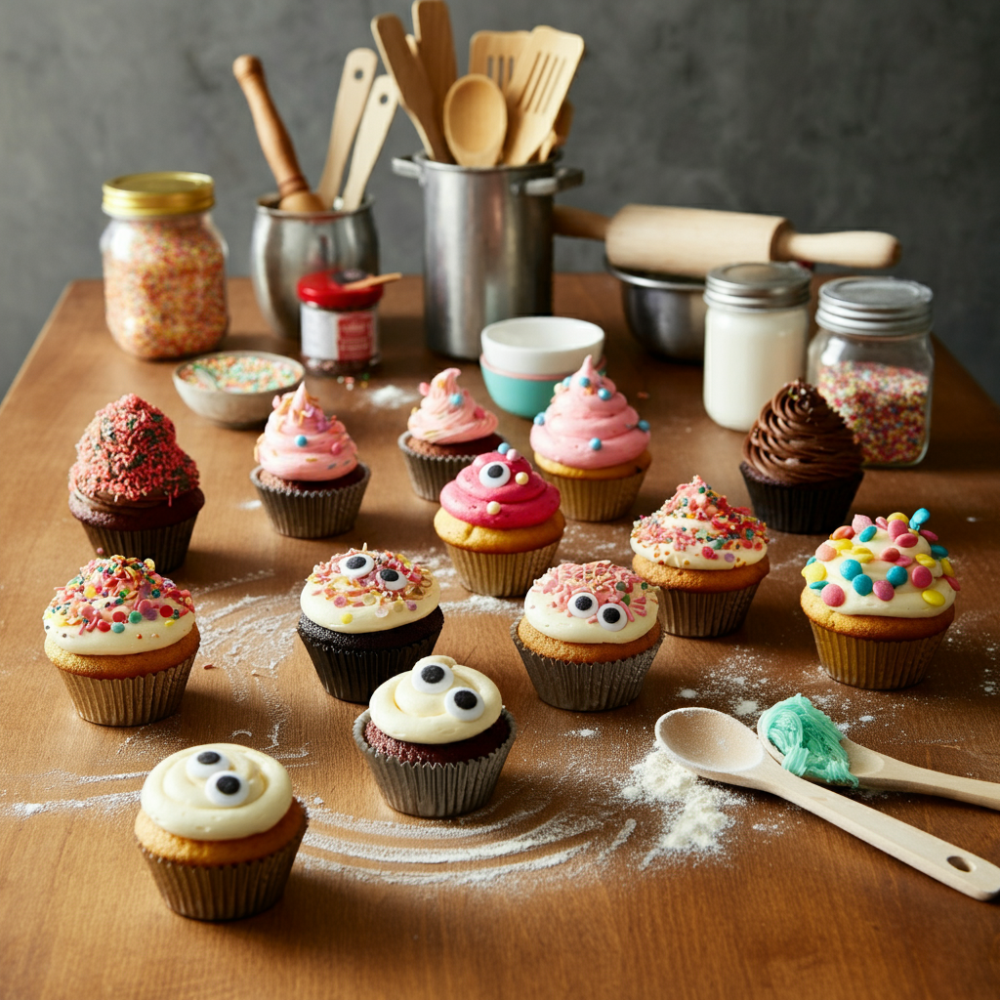

In [21]:
const CUPCAKE_IMAGE_PATH = path.join("../assets/spatial_understanding/Cupcakes.jpg");
tslab.display.jpeg(fs.readFileSync(CUPCAKE_IMAGE_PATH));


Let's start with a simple prompt to find all items in the image.

To prevent the model from repeating itself, it is recommended to use a temperature over 0, in this case 0.5. Limiting the number of items (25 in the system instructions) is also a way to prevent the model from looping and to speed up the decoding of the bounding boxes. You can experiment with these parameters and find what works best for your use-case.


In [27]:
const boundingBoxesResponse = await ai.models.generateContent({
  model: MODEL_ID,
  contents: [
    "Detect the 2d bounding boxes of the cupcakes (with “label” as topping description”)",
    google.createPartFromBase64(fs.readFileSync(CUPCAKE_IMAGE_PATH).toString("base64"), "image/jpeg"),
  ],
  config: {
    systemInstruction: BOUNDING_BOX_SYSTEM_INSTRUCTION,
    temperature: 0.5,
  },
});
console.log(boundingBoxesResponse.text);


```json
[
  {"box_2d": [389, 64, 570, 201], "label": "Dark chocolate cupcake with red and pink sprinkles"},
  {"box_2d": [383, 250, 538, 367], "label": "Light pink frosting with small pink sprinkles"},
  {"box_2d": [366, 397, 501, 506], "label": "Pink frosting with light blue candy balls"},
  {"box_2d": [353, 529, 521, 650], "label": "Pink frosting with blue candy balls"},
  {"box_2d": [384, 737, 535, 865], "label": "Plain chocolate frosting cupcake"},
  {"box_2d": [476, 627, 636, 768], "label": "White frosting with red, yellow, blue, and pink sprinkles (top-right)"},
  {"box_2d": [509, 799, 688, 959], "label": "White frosting with red, yellow, blue, and pink sprinkles (middle-right)"},
  {"box_2d": [554, 40, 723, 199], "label": "White frosting with mixed colorful sprinkles (front-left)"},
  {"box_2d": [546, 296, 700, 442], "label": "White frosting with candy eyes and yellow/red sprinkles (middle-left)"},
  {"box_2d": [442, 433, 595, 563], "label": "Bright pink frosting with candy eyes

As you can see, even without any instructions about the format, Gemini is trained to always use this format with a label and the coordinates of the bounding box in a "box_2d" array.

Just be careful, the y coordinates are first, x ones afterwards contrary to common usage.


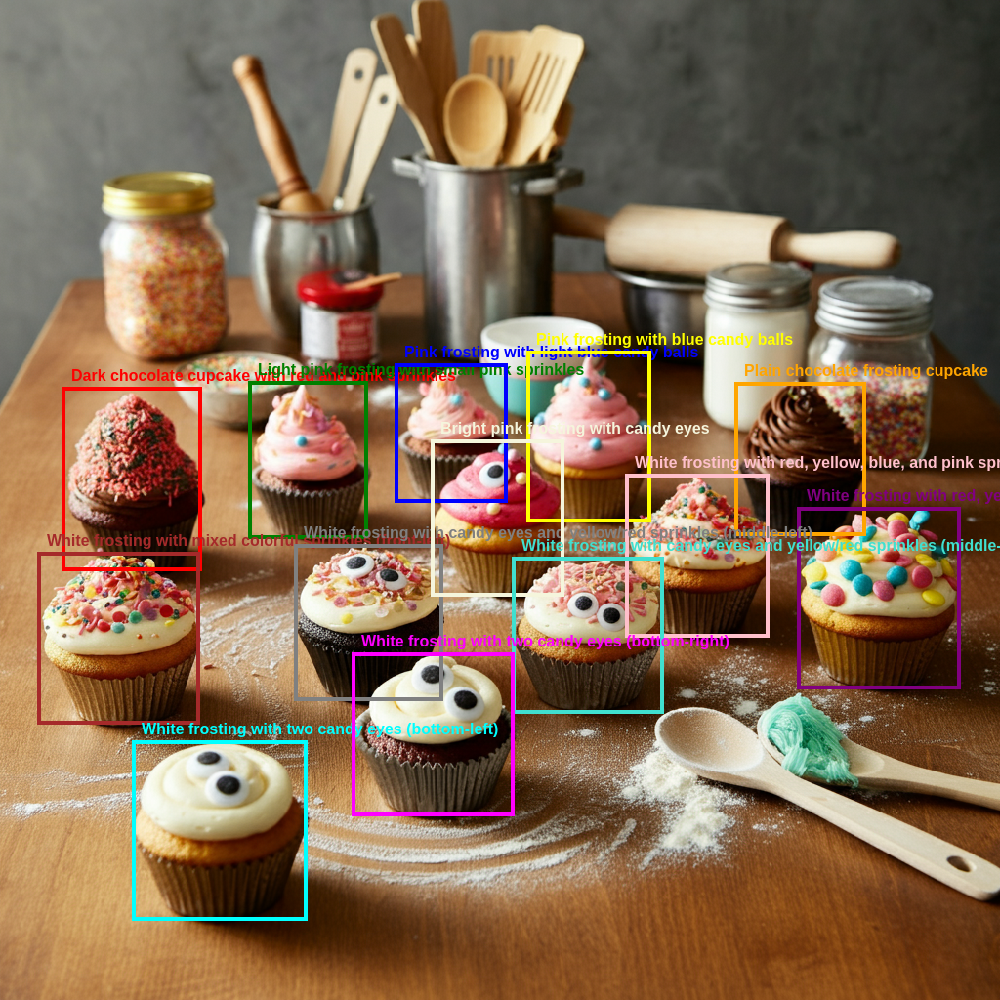

In [53]:
await plotBoundingBoxes(CUPCAKE_IMAGE_PATH, boundingBoxesResponse.text ?? "[]");


## Search within an image

Let's complicate things and search within the image for specific objects.


In [46]:
const SOCKS_IMAGE_PATH = path.join("../assets/spatial_understanding/Socks.jpg");

const socksBoundingBoxesResponse = await ai.models.generateContent({
  model: MODEL_ID,
  contents: [
    "Show me the positions of the socks with the face",
    google.createPartFromBase64(fs.readFileSync(SOCKS_IMAGE_PATH).toString("base64"), "image/jpeg"),
  ],
  config: {
    systemInstruction: BOUNDING_BOX_SYSTEM_INSTRUCTION,
    temperature: 0.5,
  },
});
console.log(socksBoundingBoxesResponse.text);


[
  {"box_2d": [240, 650, 649, 860], "label": "socks with the face"},
  {"box_2d": [53, 248, 384, 524], "label": "socks with the face"}
]


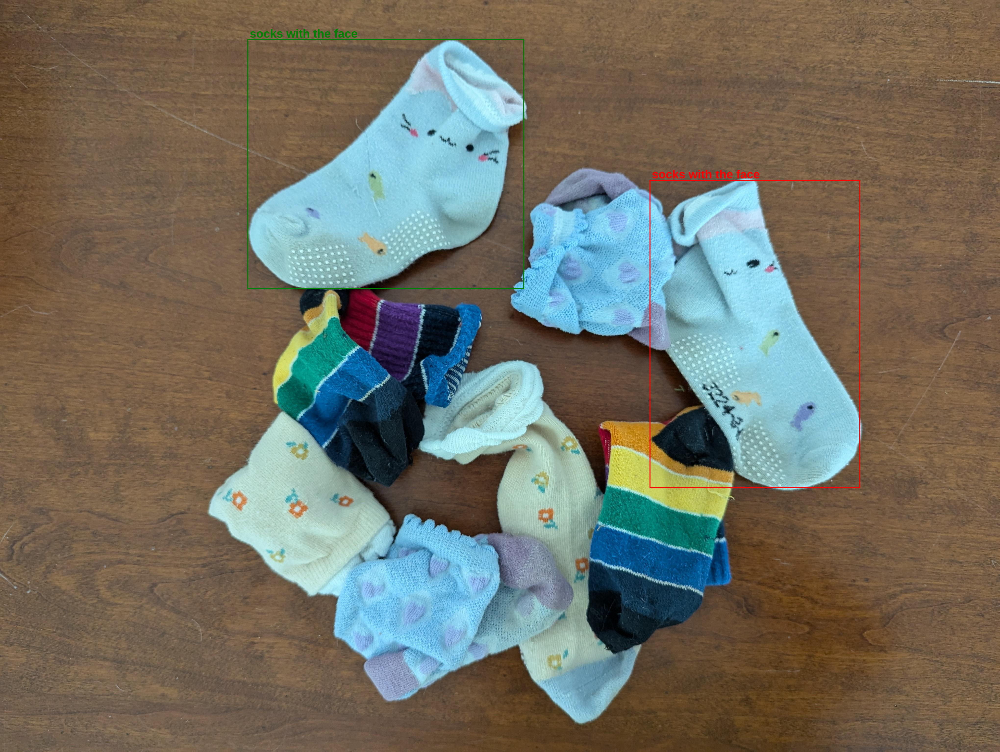

In [54]:
await plotBoundingBoxes(SOCKS_IMAGE_PATH, socksBoundingBoxesResponse.text ?? "[]");


Try it with different images and prompts. Different samples are proposed but you can also write your own.


## Multilinguality

As Gemini is able to understand multiple languages, you can combine spatial reasoning with multilingual capabilities.

You can give it an image like this and prompt it to label each item with Japanese characters and English translation. The model reads the text and recognize the pictures from the image itself and translates them.


In [55]:
const JAPANESE_BENTO_IMAGE_PATH = path.join("../assets/spatial_understanding/Japanese_bento.png");

const japaneseBentoBoundingBoxesResponse = await ai.models.generateContent({
  model: MODEL_ID,
  contents: [
    "Detect food, label them with Japanese characters + english translation.",
    google.createPartFromBase64(fs.readFileSync(JAPANESE_BENTO_IMAGE_PATH).toString("base64"), "image/png"),
  ],
  config: {
    systemInstruction: BOUNDING_BOX_SYSTEM_INSTRUCTION,
    temperature: 0.5,
  },
});
console.log(japaneseBentoBoundingBoxesResponse.text);


```json
[
  {"box_2d": [63, 56, 237, 259], "label": "抹茶のスイスロール (Matcha Swiss Roll)"},
  {"box_2d": [62, 363, 225, 595], "label": "あんパン (Anpan)"},
  {"box_2d": [55, 683, 243, 912], "label": "さきイカ (Sakiika)"},
  {"box_2d": [379, 31, 537, 287], "label": "梅干し (Umeboshi)"},
  {"box_2d": [372, 361, 555, 595], "label": "たい焼き (Taiyaki)"},
  {"box_2d": [361, 674, 555, 920], "label": "あずき最中 (Azuki Monaka)"},
  {"box_2d": [727, 24, 870, 305], "label": "お握り (Onigiri)"},
  {"box_2d": [705, 358, 864, 602], "label": "桜餅 (Sakuramochi)"},
  {"box_2d": [702, 670, 856, 918], "label": "海苔巻煎餅 (Norimaki Senbei)"}
]
```


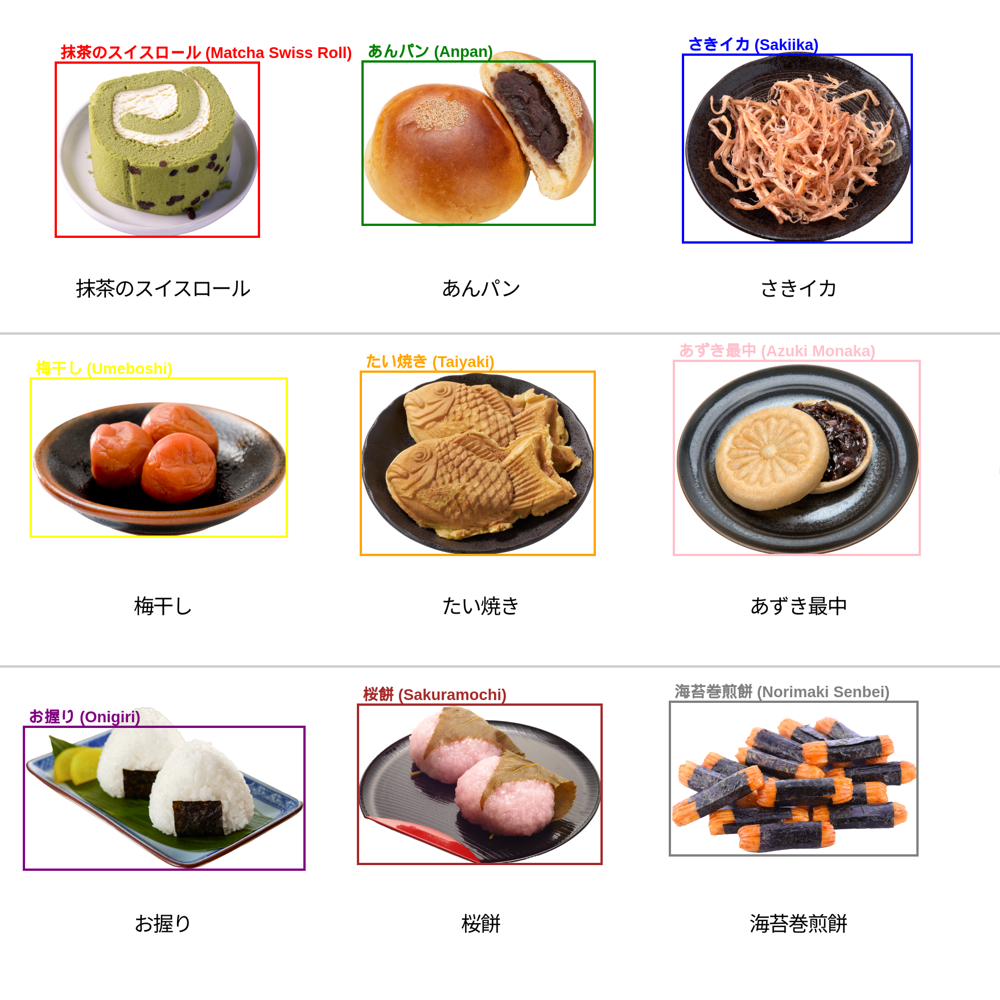

In [56]:
await plotBoundingBoxes(JAPANESE_BENTO_IMAGE_PATH, japaneseBentoBoundingBoxesResponse.text ?? "[]");


## Use Gemini reasoning capabilities

The model can also reason based on the image, you can ask it about the positions of items, their utility, or, like in this example, to find the shadow of a speficic item.


In [57]:
const ORIGAMI_IMAGE_PATH = path.join("../assets/spatial_understanding/Origamis.jpg");

const origamiBoundingBoxesResponse = await ai.models.generateContent({
  model: MODEL_ID,
  contents: [
    "Draw a square around the fox' shadow",
    google.createPartFromBase64(fs.readFileSync(ORIGAMI_IMAGE_PATH).toString("base64"), "image/jpeg"),
  ],
  config: {
    systemInstruction: BOUNDING_BOX_SYSTEM_INSTRUCTION,
    temperature: 0.5,
  },
});
console.log(origamiBoundingBoxesResponse.text);


```json
[
  {"box_2d": [435, 256, 608, 411], "label": "fox' shadow"}
]
```


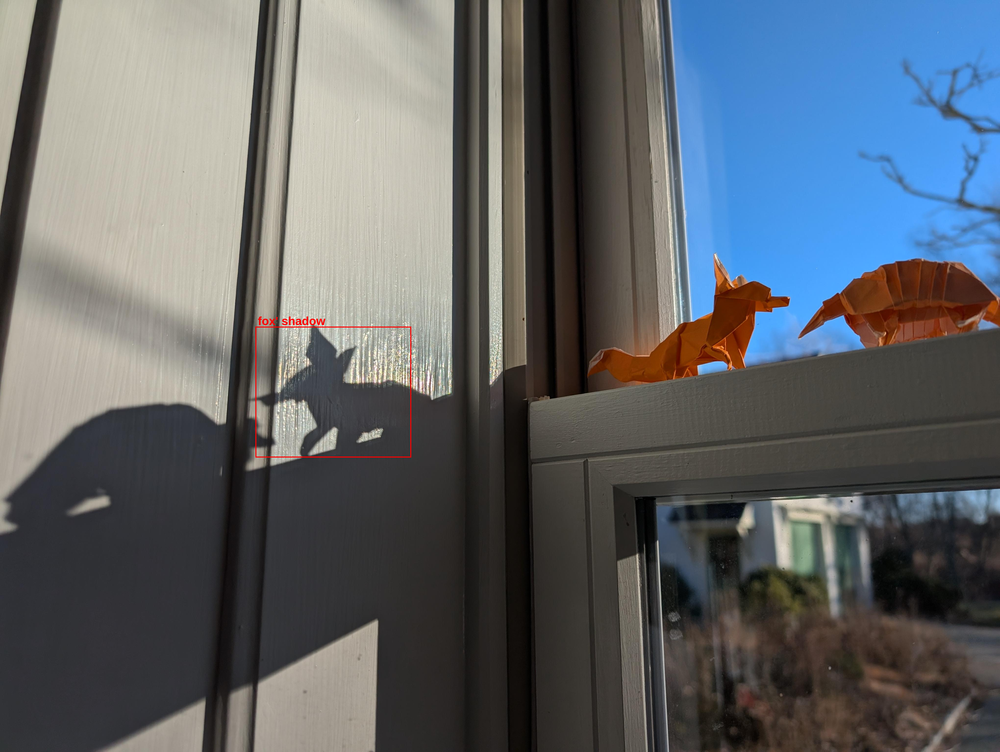

In [58]:
await plotBoundingBoxes(ORIGAMI_IMAGE_PATH, origamiBoundingBoxesResponse.text ?? "[]");


You can also use Gemini knowledge to enhanced the labels returned. In this example Gemini will give you advices on how to fix your little mistake.


In [59]:
const SPILL_IMAGE_PATH = path.join("../assets/spatial_understanding/Spill.jpg");

const spillBoundingBoxesResponse = await ai.models.generateContent({
  model: MODEL_ID,
  contents: [
    "Tell me how to clean my table with an explanation as label. Do not just label the items",
    google.createPartFromBase64(fs.readFileSync(SPILL_IMAGE_PATH).toString("base64"), "image/jpeg"),
  ],
  config: {
    systemInstruction: BOUNDING_BOX_SYSTEM_INSTRUCTION,
    temperature: 0.5,
  },
});
console.log(spillBoundingBoxesResponse.text);


```json
[
  {"box_2d": [447, 0, 1000, 417], "label": "cleaning cloth: Use this cloth to gently blot and wipe the spilled liquid from the table surface."},
  {"box_2d": [432, 606, 663, 874], "label": "liquid spill: This is the substance that needs to be cleaned from the table."},
  {"box_2d": [200, 299, 508, 517], "label": "sugar bowl: Move this item aside to ensure thorough cleaning of the table surface underneath and around it."},
  {"box_2d": [106, 556, 220, 699], "label": "sugar container: Move this item aside to ensure thorough cleaning of the table surface underneath and around it."},
  {"box_2d": [287, 140, 467, 314], "label": "knives: Carefully move these sharp objects to a safe location before cleaning to prevent injury and allow full access to the table surface."},
  {"box_2d": [108, 843, 360, 1000], "label": "wooden object: Move this item aside to ensure thorough cleaning of the table surface underneath and around it."},
  {"box_2d": [113, 224, 280, 492], "label": "wooden sta

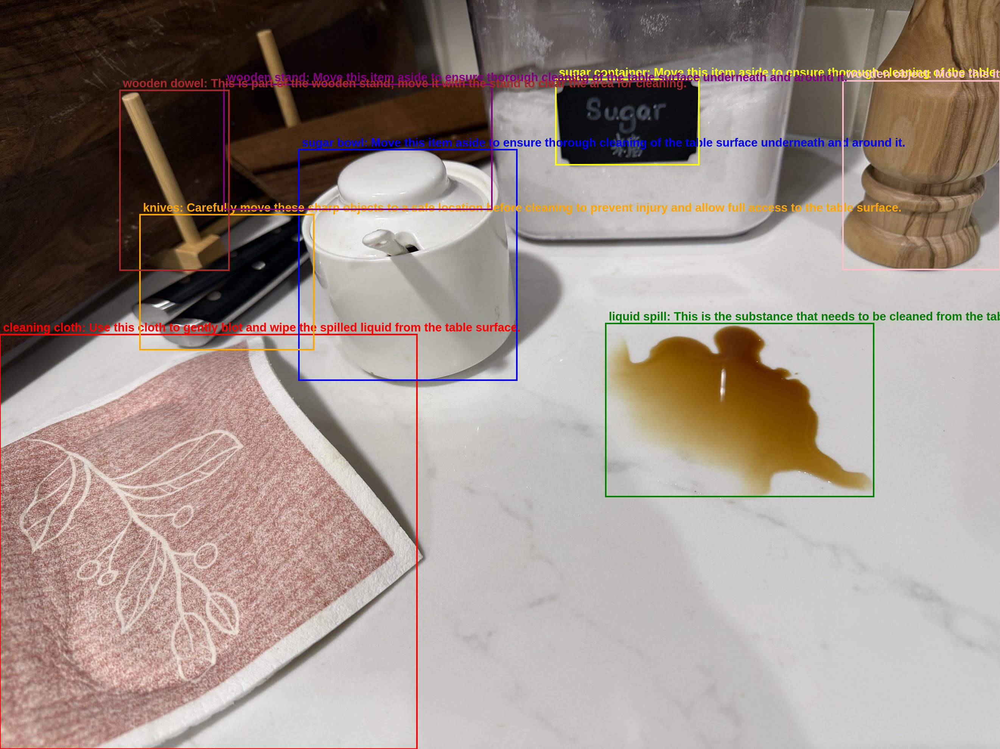

In [60]:
await plotBoundingBoxes(SPILL_IMAGE_PATH, spillBoundingBoxesResponse.text ?? "[]");


And if you check the previous examples, the [Japanese food](#multilinguality) one in particular, multiple other prompt samples are provided to experiment with Gemini reasoning capabilities.


## Experimental: Segmentation

2.5 models are also able to segment the image and not only draw a bounding box but to also provide a mask of the contour of the items. It's especially useful if you are planning on editing images like in the [Virtual try-on](../examples/Virtual_Try_On.ipynb) example.


In [68]:
import { CanvasRenderingContext2D } from "canvas";

interface SegmentationMask {
  y0: number;
  x0: number;
  y1: number;
  x1: number;
  mask: Uint8ClampedArray; // flat array of grayscale pixels
  label: string;
}

interface Box2D {
  box_2d: [number, number, number, number]; // [y0, x0, y1, x1]
  label: string;
  mask: string; // base64 PNG
}

interface RGBColor {
  r: number;
  g: number;
  b: number;
}

const rgbColors: RGBColor[] = [
  { r: 255, g: 0, b: 0 }, // Red
  { r: 0, g: 255, b: 0 }, // Green
  { r: 0, g: 0, b: 255 }, // Blue
  { r: 255, g: 255, b: 0 }, // Yellow
  { r: 255, g: 165, b: 0 }, // Orange
  { r: 255, g: 192, b: 203 }, // Pink
  { r: 128, g: 0, b: 128 }, // Purple
  { r: 165, g: 42, b: 42 }, // Brown
  { r: 128, g: 128, b: 128 }, // Gray
  { r: 245, g: 245, b: 220 }, // Beige
  { r: 64, g: 224, b: 208 }, // Turquoise
  { r: 0, g: 255, b: 255 }, // Cyan
  { r: 255, g: 0, b: 255 }, // Magenta
  { r: 50, g: 205, b: 50 }, // Lime
  { r: 0, g: 0, b: 128 }, // Navy
  { r: 128, g: 0, b: 0 }, // Maroon
  { r: 0, g: 128, b: 128 }, // Teal
  { r: 128, g: 128, b: 0 }, // Olive
  { r: 255, g: 127, b: 80 }, // Coral
  { r: 230, g: 230, b: 250 }, // Lavender
  { r: 238, g: 130, b: 238 }, // Violet
  { r: 255, g: 215, b: 0 }, // Gold
  { r: 192, g: 192, b: 192 }, // Silver
];

async function parseSegmentationMasks(
  predictedStr: string,
  imgHeight: number,
  imgWidth: number
): Promise<SegmentationMask[]> {
  const items = parseJSON<Box2D[]>(predictedStr);
  const masks: SegmentationMask[] = [];

  for (const item of items) {
    const [normY0, normX0, normY1, normX1] = item.box_2d;
    const y0 = Math.floor((normY0 / 1000) * imgHeight);
    const x0 = Math.floor((normX0 / 1000) * imgWidth);
    const y1 = Math.floor((normY1 / 1000) * imgHeight);
    const x1 = Math.floor((normX1 / 1000) * imgWidth);

    if (y0 >= y1 || x0 >= x1) {
      console.warn("Invalid bounding box:", item.box_2d);
      continue;
    }

    let pngData = item.mask;
    if (!pngData.startsWith("data:image/png;base64,")) {
      console.warn("Invalid mask format");
      continue;
    }

    try {
      pngData = pngData.replace("data:image/png;base64,", "");
      const pngBuffer = Buffer.from(pngData, "base64");
      const maskImage = await canvas.loadImage(pngBuffer);

      const bboxWidth = x1 - x0;
      const bboxHeight = y1 - y0;

      const tempCanvas = canvas.createCanvas(bboxWidth, bboxHeight);
      const ctx = tempCanvas.getContext("2d");
      ctx.drawImage(maskImage, 0, 0, bboxWidth, bboxHeight);

      const imageData = ctx.getImageData(0, 0, bboxWidth, bboxHeight);
      const gray = new Uint8ClampedArray(bboxWidth * bboxHeight);

      for (let i = 0; i < bboxWidth * bboxHeight; i++) {
        const idx = i * 4;
        // Use red channel as mask value (PNG grayscale mask is usually replicated across channels)
        gray[i] = imageData.data[idx];
      }

      masks.push({
        y0,
        x0,
        y1,
        x1,
        mask: gray,
        label: item.label,
      });
    } catch (err) {
      console.error("Error parsing mask:", err);
      continue;
    }
  }
  return masks;
}

function overlayMaskOnImage(
  ctx: CanvasRenderingContext2D,
  mask: Uint8ClampedArray,
  imgWidth: number,
  imgHeight: number,
  x0: number,
  y0: number,
  x1: number,
  y1: number,
  color: RGBColor,
  alpha = 0.6
) {
  const width = x1 - x0;
  const height = y1 - y0;
  const imageData = ctx.getImageData(0, 0, imgWidth, imgHeight);
  const [r, g, b] = [color.r, color.g, color.b];

  for (let y = 0; y < height; y++) {
    for (let x = 0; x < width; x++) {
      const idx = y * width + x;
      if (mask[idx] > 127) {
        const px = (imgWidth * (y0 + y) + (x0 + x)) * 4;
        imageData.data[px] = r * alpha + imageData.data[px] * (1 - alpha);
        imageData.data[px + 1] = g * alpha + imageData.data[px + 1] * (1 - alpha);
        imageData.data[px + 2] = b * alpha + imageData.data[px + 2] * (1 - alpha);
      }
    }
  }
  ctx.putImageData(imageData, 0, 0);
}

async function plotSegmentationMasks(imageBuffer: Buffer, segmentationMasks: SegmentationMask[]): Promise<void> {
  const baseImg = await canvas.loadImage(imageBuffer);
  const image_canvas = canvas.createCanvas(baseImg.width, baseImg.height);
  const ctx = image_canvas.getContext("2d");

  ctx.drawImage(baseImg, 0, 0);

  segmentationMasks.forEach((mask, i) => {
    const color = rgbColors[i % rgbColors.length];
    overlayMaskOnImage(ctx, mask.mask, baseImg.width, baseImg.height, mask.x0, mask.y0, mask.x1, mask.y1, color);
  });

  ctx.lineWidth = 4;
  ctx.font = "bold 14px sans-serif";

  segmentationMasks.forEach((mask, i) => {
    const color = rgbColors[i % rgbColors.length];
    ctx.strokeStyle = `rgba(${color.r}, ${color.g}, ${color.b}, 0.8)`;
    ctx.strokeRect(mask.x0, mask.y0, mask.x1 - mask.x0, mask.y1 - mask.y0);
  });

  segmentationMasks.forEach((mask, i) => {
    const color = rgbColors[i % rgbColors.length];
    if (mask.label) {
      ctx.fillStyle = `rgba(${color.r}, ${color.g}, ${color.b}, 0.8)`;
      ctx.fillText(mask.label, mask.x0 + 8, mask.y0 - 6);
    }
  });

  const buffer = image_canvas.toBuffer();
  tslab.display.png(new Uint8Array(buffer));
}


```json
[
  {"box_2d": [156, 395, 362, 579], "mask": "", "label": "metal pot"},
  {"box_2d": [197, 249, 340, 381], "mask": "", "label": "metal pot"},
  {"box_2d": [267, 617, 363, 709], "mask": "", "label": "metal mixing bowl"},
  {"box_2d": [170, 96, 361, 229], "mask": "", "label": "glass jar"},
  {"box_2d": [276, 804, 467, 937], "mask": "", "label": "glass jar"},
  {"box_2d": [260, 701, 431, 811], "mask": "", "label": "glass jar"},
  {"box_2d": [203, 597, 276, 895], "mask": "", "label": "wooden rolling pin"},
  {"box_2d": [706, 652, 900, 999], "mask": "", "label": "wooden spoon"},
  {"box_2d": [701, 755, 811, 999], "mask": "", "label": "wooden spoon"},
  {"box_2d": [47, 321, 212, 399], "mask": "", "label": "wooden spatula"},
  {"box_2d": [0, 370, 166, 458], "mask": "", "label": "wooden spatula"},
  {"box_2d": [27, 465, 166, 584], "mask": "", "label": "wooden spatula"},
  {"box_2d": [73, 442, 169, 508], "mask": "", "label": "wooden spoon"},
  {"box_2d": [56, 230, 215, 329], "mask": "",
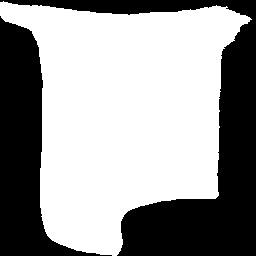
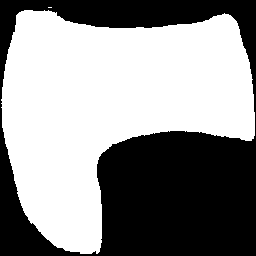
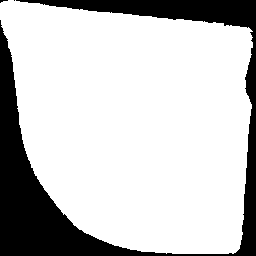
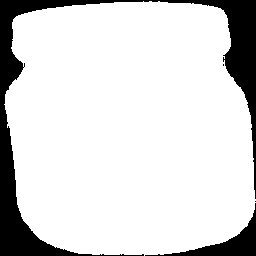
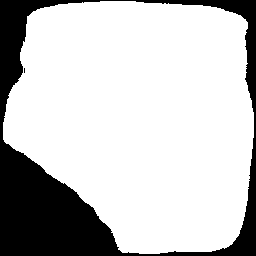
...
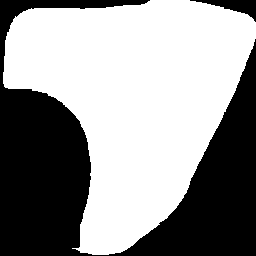
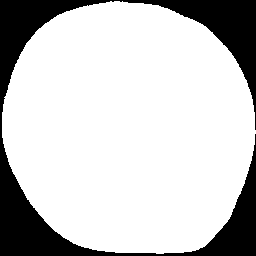
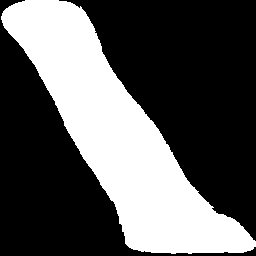
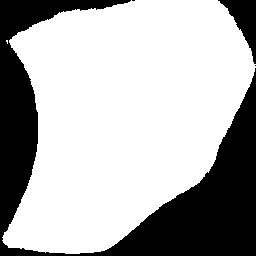
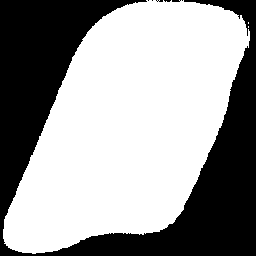

In [72]:
const SEGMENTATION_PROMPT =
  'Give the segmentation masks for the metal, wooden and glass small items (ignore the table). Output a JSON list of segmentation masks where each entry contains the 2D bounding box in the key "box_2d", the segmentation mask in key "mask", and the text label in the key "label". Use descriptive labels.';

const segmentationResponse = await ai.models.generateContent({
  model: MODEL_ID,
  contents: [
    SEGMENTATION_PROMPT,
    google.createPartFromBase64(fs.readFileSync(CUPCAKE_IMAGE_PATH).toString("base64"), "image/jpeg"),
  ],
  config: {
    temperature: 0.5,
  },
});
console.log(segmentationResponse.text);


The model predicts a JSON list, where each item represents a segmentation mask. Each item has a bounding box (`"box_2d"`) in the format `[y0, x0, y1, x1]` with normalized coordinates between 0 and 1000, a label (`"label"`) that identifies the object, and lastly the segmentation mask inside the bounding box, as base64 encoded png.

To use the mask, first you need to do base64 decoding, and then loading this string as a png. This will give you a probability map with values between 0 and 255. The mask needs to be resized to match the bounding box dimensions, then you can apply your confidence threshold, e.g. binarizing at 127 for the midpoint. Finally, pad the mask into an array of the size of the full image.

All these steps are done by the the `parseSegmentationMasks` function provided earlier.

Ultimately, use the `plotSegmentationMasks` function to visualize the decoded masks by overlaying it on the image.


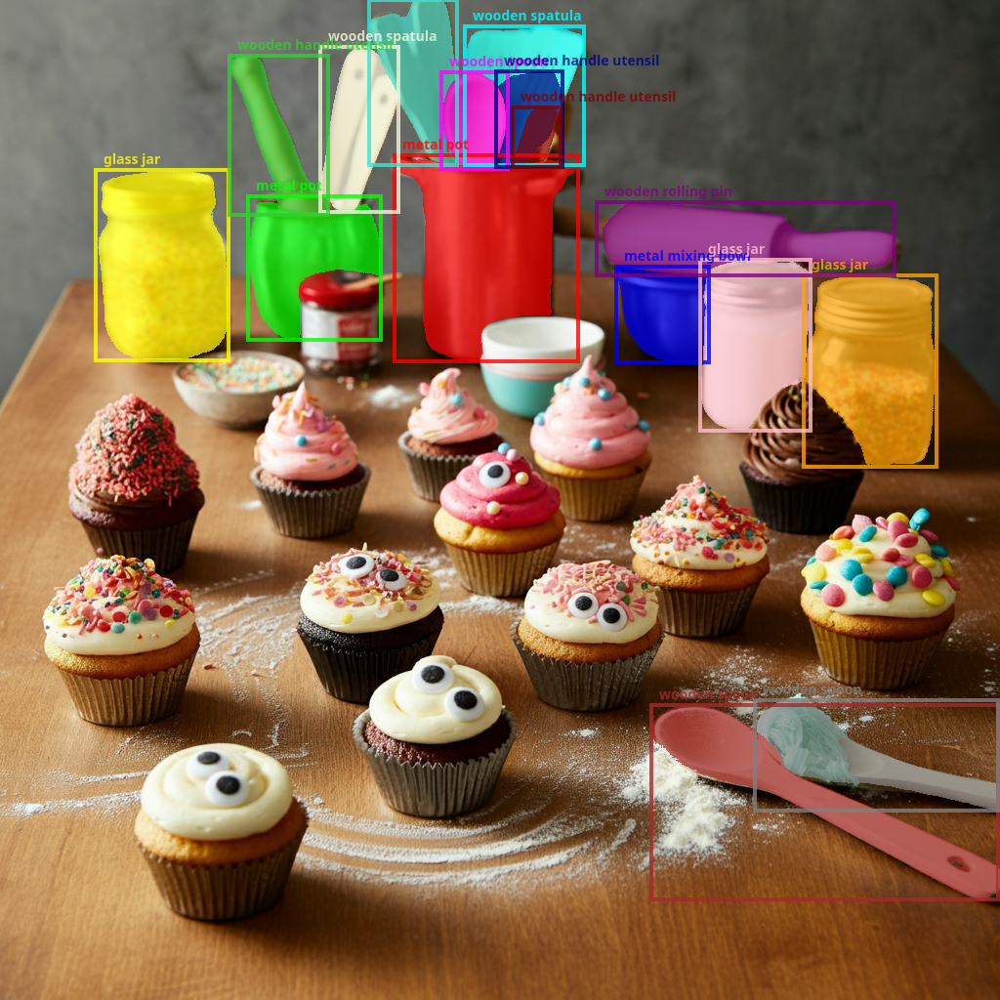

In [73]:
const segmentationMasks = await parseSegmentationMasks(segmentationResponse.text ?? "[]", 1024, 1024);
await plotSegmentationMasks(fs.readFileSync(CUPCAKE_IMAGE_PATH), segmentationMasks);


## Preliminary capabilities: pointing and 3D boxes

Pointing and 3D bounding boxes are experimental model capabilities. Check this [other notebook](../examples/Spatial_understanding_3d.ipynb) to get a sneak peek on those upcoming capabilities.

![Box 3D](https://storage.googleapis.com/generativeai-downloads/images/box_3d.png)



## What's next?

For a more end-to-end example, the code from the [AI Studio Spatial understanding example](https://aistudio.google.com/starter-apps/spatial)  is available on [Github](https://github.com/google-gemini/starter-applets/tree/main/spatial).

You'll also find multiple other examples of Gemini capabilities in the [Gemini cookbook](https://github.com/FallenDeity/deepmind-starter), in particular the [Live API](Get_started_LiveAPI.ipynb) and the [video understanding](Video_understanding.ipynb) one.

Related to image recognition and reasoning, [Market a jet backpack](../examples/Market_a_Jet_Backpack.ipynb) and [Guess the shape](../examples/Guess_the_shape.ipynb) examples are worth checking to continue your Gemini API discovery (Note: these examples still use the old SDK). And of course the [pointing and 3d boxes](../examples/Spatial_understanding_3d.ipynb) example referenced earlier.
